In [24]:
import pandas as pd
import numpy as np
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.preprocessing import scale
from sklearn import tree, svm, metrics
import matplotlib.pyplot as plt
import os
import glob

pd.set_option('display.max_columns', None)

## More Cleaning

In [25]:
path = os.getcwd()
path = path + '\scraped_data_final'
csv_files = glob.glob(os.path.join(path, '*.csv'))
df_list = []
label_list = []
for f in csv_files:
    df_list.append(pd.read_csv(f))
    if 'mid_team' in f:
        label_list.append(0)
    elif 'worst_team' in f:
        label_list.append(0)
    elif 'runn_up' in f:
        label_list.append(2)
    else:
        label_list.append(1)

In [26]:
df_list[0].head()

,Unnamed: 0,Rk,Gtm,Date,Unnamed: 3,Opp,Rslt,PA,AB,R,H,2B,3B,HR,RBI,BB,IBB,SO,HBP,SH,SF,ROE,GDP,SB,CS,BA,OBP,SLG,OPS,LOB,#,Thr,Opp. Starter (GmeSc)
0,0,1,1,Apr 3,NaN,NYY,"L,2-3",40,35,2,10,1,0,1,2,5,0,6,0,0,0,0,0,0,1,0.286,0.375,0.400,0.775,11,11,R,O.Hernandez(58)
1,1,2,2,Apr 4,NaN,NYY,"L,3-5",42,36,3,10,0,0,0,3,6,0,9,0,0,0,1,2,1,0,0.282,0.378,0.338,0.716,12,9,R,R.Clemens(54)
2,2,3,3,Apr 5,NaN,NYY,"W,12-6",44,33,12,12,4,0,1,12,8,0,4,1,0,2,0,0,1,0,0.308,0.413,0.413,0.826,8,10,R,D.Cone(14)
3,3,4,4,Apr 7,NaN,BOS,"W,7-3",38,32,7,9,2,0,2,7,5,2,5,0,1,0,0,0,3,0,0.301,0.405,0.441,0.846,7,10,L,P.Schourek(47)
4,4,5,5,Apr 8,NaN,BOS,"W,7-5",37,35,7,13,4,0,1,7,1,0,4,0,1,0,0,0,0,1,0.316,0.402,0.468,0.870,6,10,R,B.Rose(29)


In [27]:
for i in range(len(df_list)):
    try:
        df_list[i] = df_list[i].drop(['Unnamed: 0', 'Rk', 'Gtm', 'Date', 'Unnamed: 3', 'Opp', 'Umpire', 'Pitchers Used (Rest-GameScore-Dec)'], axis=1)
    except:
        pass
    try:
        df_list[i] = df_list[i].drop(['Unnamed: 0', 'Rk', 'Gtm', 'Date', 'Unnamed: 3', 'Opp', 'Thr', 'Opp. Starter (GmeSc)'], axis=1)
    except:
        pass

In [28]:
df_list[30].head()

,Rslt,IP,H,R,ER,UER,BB,SO,HR,HBP,ERA,BF,Pit,Str,IR,IS,SB,CS,AB,2B,3B,IBB,SH,SF,ROE,GDP,#
0,"W,9-2",9.0,9,2,2,0,0,7,0,0,2.00,36,137,96,0.0,0.0,0,0,36,1,1,0,0,0,0,0,3
1,"W,10-2",9.0,7,2,2,0,3,5,1,2,2.00,37,143,95,2.0,0.0,0,0,32,1,0,0,0,0,0,2,4
2,"W,6-3",12.0,7,3,3,0,6,12,0,0,2.10,50,198,125,3.0,0.0,0,0,43,2,0,0,1,0,1,0,7
3,"L,0-4",8.0,8,4,4,0,2,5,1,0,2.61,34,115,76,0.0,0.0,1,0,32,1,0,0,0,0,0,0,2
4,"L,5-6",11.1,11,6,6,0,7,9,0,2,3.10,52,232,135,2.0,2.0,0,0,43,4,1,2,0,0,0,2,6


In [29]:
for i in range(len(df_list)):
    temp = []
    temp_our_score = []
    temp_their_score = []
    temp_diff_score = []
    for j in range(len(df_list[i]['Rslt'])):
        
        temp_str_array = df_list[i]['Rslt'][j].split(',')
        temp_score_array = temp_str_array[1].split('-')
        
        temp_our_score.append(int(temp_score_array[0]))
        temp_their_score.append(int(temp_score_array[1]))
        temp_diff_score.append(int(temp_score_array[0]) - int(temp_score_array[1]))
        
        if 'W' in df_list[i]['Rslt'][j]:
            temp.append(1)
        elif 'L' in df_list[i]['Rslt'][j]:
            temp.append(0)
        else:
            temp.append(-1)
    df_list[i]['Result Binary'] = temp
    df_list[i]['Our Score'] = temp_our_score
    df_list[i]['Their Score'] = temp_their_score
    df_list[i]['Score Differential'] = temp_diff_score
    df_list[i] = df_list[i].drop(['Rslt'], axis=1)

# for i in range(len(df_list)):
#     df_list[i]['Results Binary'] = np.where('W' in df_list[i]['Rslt'], 1, 0)

In [30]:
print(df_list[0].columns)
print(len(df_list[0].columns))
print(len(df_list[30].columns))
df_list[30].head()

Index(['PA', 'AB', 'R', 'H', '2B', '3B', 'HR', 'RBI', 'BB', 'IBB', 'SO', 'HBP',
       'SH', 'SF', 'ROE', 'GDP', 'SB', 'CS', 'BA', 'OBP', 'SLG', 'OPS', 'LOB',
       '#', 'Result Binary', 'Our Score', 'Their Score', 'Score Differential'],
      dtype='object')
28
30


,IP,H,R,ER,UER,BB,SO,HR,HBP,ERA,BF,Pit,Str,IR,IS,SB,CS,AB,2B,3B,IBB,SH,SF,ROE,GDP,#,Result Binary,Our Score,Their Score,Score Differential
0,9.0,9,2,2,0,0,7,0,0,2.00,36,137,96,0.0,0.0,0,0,36,1,1,0,0,0,0,0,3,1,9,2,7
1,9.0,7,2,2,0,3,5,1,2,2.00,37,143,95,2.0,0.0,0,0,32,1,0,0,0,0,0,2,4,1,10,2,8
2,12.0,7,3,3,0,6,12,0,0,2.10,50,198,125,3.0,0.0,0,0,43,2,0,0,1,0,1,0,7,1,6,3,3
3,8.0,8,4,4,0,2,5,1,0,2.61,34,115,76,0.0,0.0,1,0,32,1,0,0,0,0,0,0,2,0,0,4,-4
4,11.1,11,6,6,0,7,9,0,2,3.10,52,232,135,2.0,2.0,0,0,43,4,1,2,0,0,0,2,6,0,5,6,-1


## Analysis 1 - kNN
 - Compare prediction scores of batting vs pitching
 - Graph accuracy of preditions vs games used in predicting
 - Change percentage of test_size
 - Make a giant array with all variables. Find a way to track the variable within the model...?

In [31]:
X_batting = np.array([df_list[i]['HR'][0:20].values for i in range(len(df_list)) if len(df_list[i].columns) == 28])
X_pitching = np.array([df_list[i]['SO'][0:20].values for i in range(len(df_list)) if len(df_list[i].columns) == 30])
y_batting = np.array([label_list[i] for i in range(len(label_list)) if len(df_list[i].columns) == 28])
y_pitching = np.array([label_list[i] for i in range(len(label_list)) if len(df_list[i].columns) == 30])

# X_batting = scale(X_batting)
# X_pitching = scale(X_pitching)

X_train, X_test, y_train, y_test = train_test_split(X_pitching, y_pitching, random_state=1, test_size=0.7)

In [32]:
print(type(X_batting[0]))
print(type(y_batting))
print(y_batting)
print(X_batting)

<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
[[1 0 1 ... 0 0 4]
 [1 2 0 ... 2 2 2]
 [3 1 2 ... 0 0 0]
 ...
 [2 1 0 ... 2 2 1]
 [1 1 0 ... 5 1 0]
 [1 1 0 ... 1 0 0]]


In [33]:
# acc = []
# max_acc = -1
# for i in range(2, 10):
#     current_model = KNeighborsClassifier(n_neighbors = i)
#     scores = cross_val_score(estimator= current_model, X= df_list_batting, y= label_list_batting, cv=5, scoring='accuracy')
#     av = np.mean(scores)
    
#     acc.append(av)
#     if av > max_acc:
#         max_acc = av
#         max_k = i

# A
model = KNeighborsClassifier(n_neighbors = 10)
model.fit(X_pitching, y_pitching)

# B
y_pred = model.predict(X_test)
print('Accuracy = ', metrics.accuracy_score(y_true = y_test, y_pred = y_pred))
print(metrics.confusion_matrix(y_true = y_test, y_pred = y_pred))

Accuracy =  0.7419354838709677
[[62  0  0]
 [12  1  1]
 [11  0  6]]


c:\Users\attig\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


In [34]:
# batting
batting_prediction_accuracy = []
num_of_games_batting = []
for j in range(len(df_list[0].columns)):
    if (df_list[0].columns[j] != 'SH') and (df_list[0].columns[j] != 'ROE') and (df_list[0].columns[j] != 'SB') and (df_list[0].columns[j] != 'IBB') and (df_list[0].columns[j] != 'SF'):
        accuracy = []
        x_range = []
        for k in range(20, 150):
            acc_temp = []
            neighbors_temp = []
            
            X_batting = np.array([df_list[i][df_list[i].columns[j]][0:k].values for i in range(len(df_list)) if len(df_list[i].columns) == 28])
            y_batting = np.array([label_list[i] for i in range(len(label_list)) if len(df_list[i].columns) == 28])
            
            X_train, X_test, y_train, y_test = train_test_split(X_batting, y_batting, random_state=1, test_size=0.7)
            for m in range(2, 8):
                try:            
                    model = KNeighborsClassifier(n_neighbors = m)
                    model.fit(X_batting, y_batting)

                    y_pred = model.predict(X_test)
                    acc_temp.append(metrics.accuracy_score(y_true = y_test, y_pred = y_pred))
                    neighbors_temp.append(m)
                    
                except:
                    pass
                
            max_acc_index = np.argmax(acc_temp)
            neighbor_max = neighbors_temp[max_acc_index]
            
            model = KNeighborsClassifier(n_neighbors = neighbor_max)
            model.fit(X_batting, y_batting)

            y_pred = model.predict(X_test)
            
            x_range.append(k)
            accuracy.append(metrics.accuracy_score(y_true = y_test, y_pred = y_pred))
            
        batting_prediction_accuracy.append(accuracy)
        num_of_games_batting.append(x_range)
  

c:\Users\attig\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
c:\Users\attig\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

In [35]:
       
# pitching
pitching_prediction_accuracy = []
num_of_games_pitching = []
for j in range(len(df_list[30].columns)):
    if (df_list[30].columns[j] != '3B') and (df_list[30].columns[j] != 'SB') and (df_list[30].columns[j] != 'HBP') and (df_list[30].columns[j] != 'CS') and (df_list[30].columns[j] != 'IBB') and (df_list[30].columns[j] != 'IR') and (df_list[30].columns[j] != 'IS'):
        accuracy = []
        x_range = []
        
        for k in range(20, 150):
            acc_temp = []
            neighbors_temp = []
            
            X_pitching = np.array([df_list[i][df_list[i].columns[j]][0:k].values for i in range(len(df_list)) if len(df_list[i].columns) == 30])
            y_pitching = np.array([label_list[i] for i in range(len(label_list)) if len(df_list[i].columns) == 30])
            
            X_train, X_test, y_train, y_test = train_test_split(X_pitching, y_pitching, random_state=1, test_size=0.7)
            for m in range(2, 8):
                try:                
                    model = KNeighborsClassifier(n_neighbors = m)
                    model.fit(X_pitching, y_pitching)

                    y_pred = model.predict(X_test)
                    acc_temp.append(metrics.accuracy_score(y_true = y_test, y_pred = y_pred))
                    neighbors_temp.append(m)
                    
                except:
                    pass
                    
            max_acc_index = np.argmax(acc_temp)
            neighbor_max = neighbors_temp[max_acc_index]
            
            model = KNeighborsClassifier(n_neighbors = neighbor_max)
            model.fit(X_pitching, y_pitching)

            y_pred = model.predict(X_test)
            
            accuracy.append(metrics.accuracy_score(y_true = y_test, y_pred = y_pred))
            x_range.append(k)
            
        pitching_prediction_accuracy.append(accuracy)
        num_of_games_pitching.append(x_range)
        

c:\Users\attig\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
c:\Users\attig\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

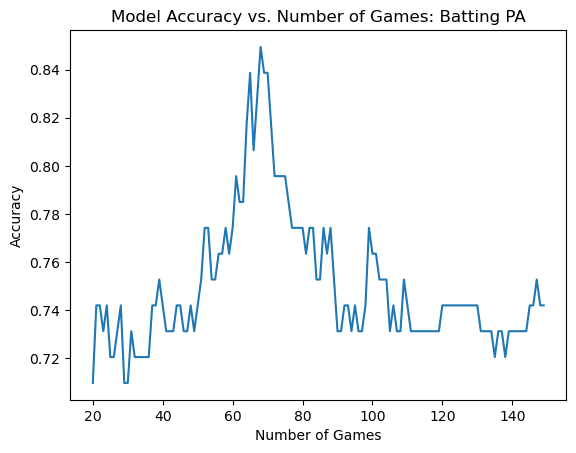

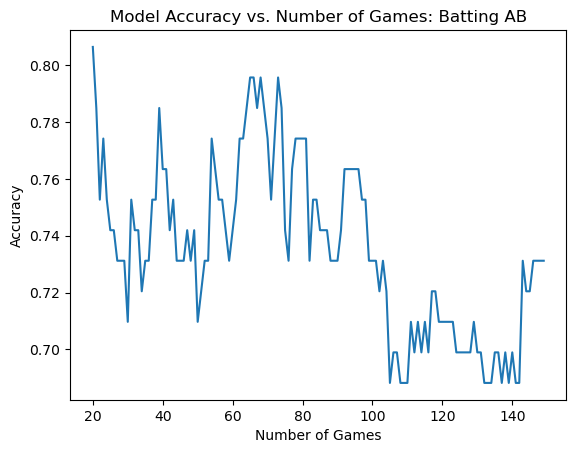

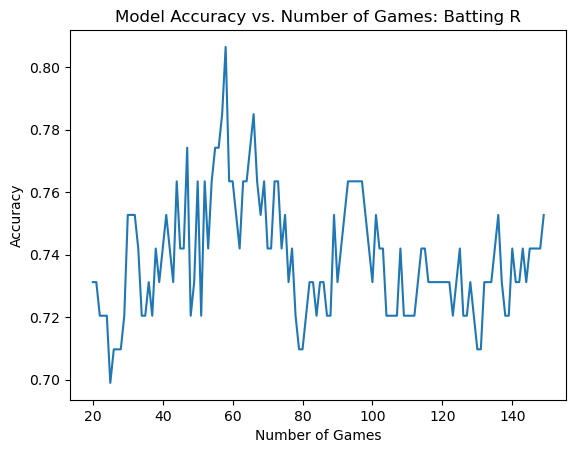

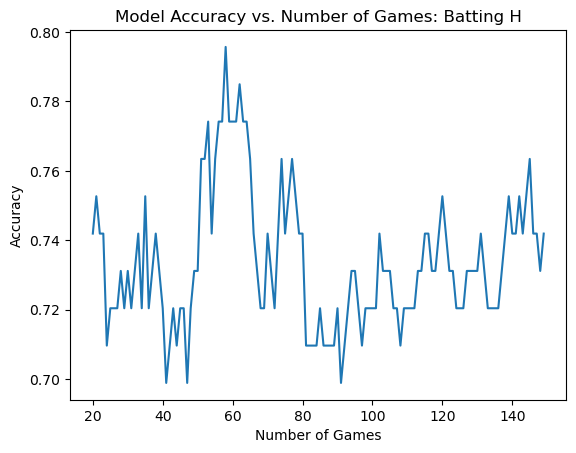

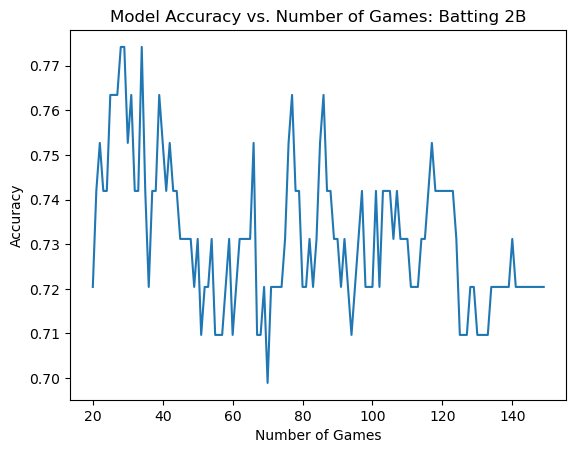

...

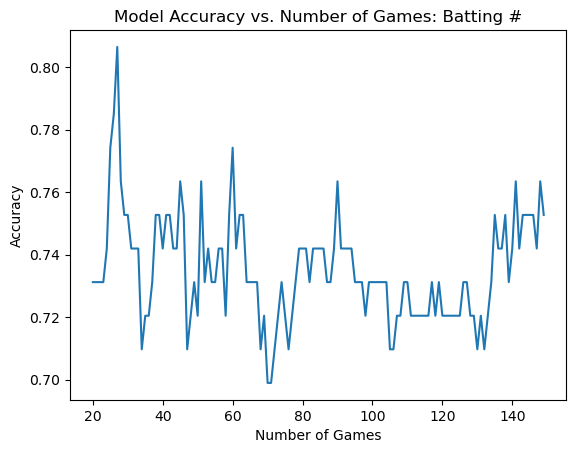

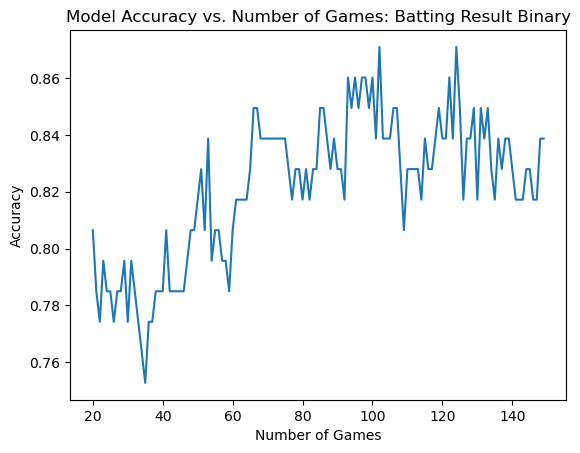

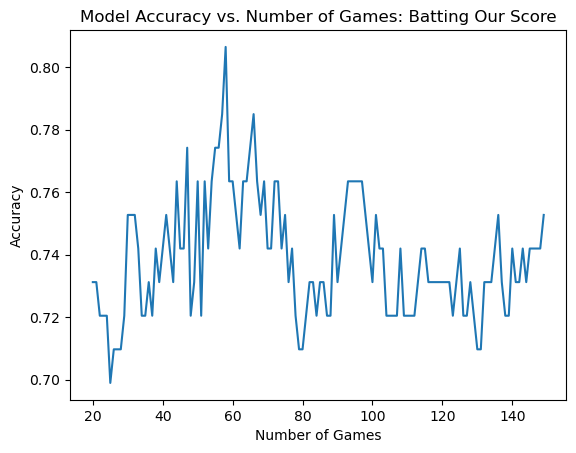

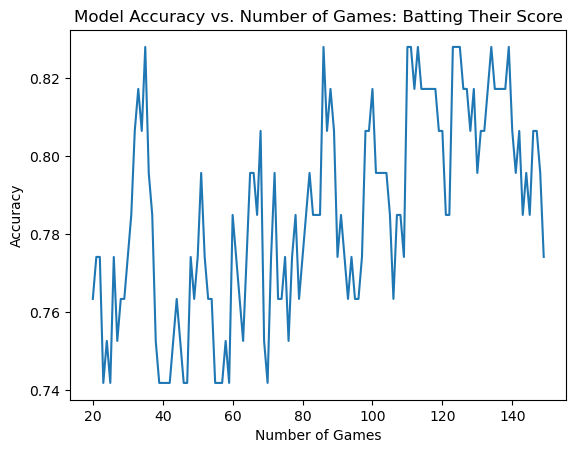

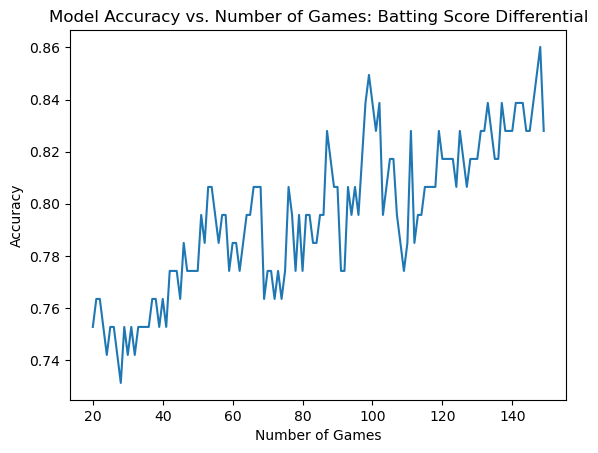

In [48]:
x=0
for i in range(len(df_list[0].columns)):
    if (df_list[0].columns[i] != 'SH') and (df_list[0].columns[i] != 'ROE') and (df_list[0].columns[i] != 'SB') and (df_list[0].columns[i] != 'IBB') and (df_list[0].columns[i] != 'SF'):
        plt.plot(num_of_games_batting[x], batting_prediction_accuracy[x])
        plt.title(f'Model Accuracy vs. Number of Games: Batting {df_list[0].columns[i]}')
        plt.xlabel(f'Number of Games')
        plt.ylabel(f'Accuracy')
        plt.savefig(f'Batting Model Accuracy__{df_list[0].columns[i]}.jpg')
        plt.show()
        x += 1

# for i in range(len(df_list[0].columns)):
#     plt.plot(num_of_games_batting[i], batting_prediction_accuracy[i])
    
# plt.title(f'Model Accuracy vs. Number of Games: Batting')
# plt.legend([f'{df_list[0].columns[i]}' for i in range(len(df_list[0].columns))])
# plt.xlabel(f'Number of Games')
# plt.ylabel(f'Accuracy')
# plt.savefig('Batting Accuracy.jpg')
# plt.show()


In [49]:
avg_acc_batting = np.mean(batting_prediction_accuracy, axis=1)

# print(f'{df_list[0].columns[27]}, average accuracy: {avg_acc_batting[27]}')
# print(f'{df_list[0].columns[24]}, average accuracy: {avg_acc_batting[24]}')
# print(f'{df_list[0].columns[21]}, average accuracy: {avg_acc_batting[21]}')
# print(f'{df_list[0].columns[20]}, average accuracy: {avg_acc_batting[20]}')
# print(f'{df_list[0].columns[19]}, average accuracy: {avg_acc_batting[19]}')
# print(f'{df_list[0].columns[18]}, average accuracy: {avg_acc_batting[18]}')
# print()
# print()
# print()
# print(f'{df_list[0].columns[12]}, average accuracy: {avg_acc_batting[12]}')
# print(f'{df_list[0].columns[14]}, average accuracy: {avg_acc_batting[14]}')
# print(f'{df_list[0].columns[16]}, average accuracy: {avg_acc_batting[16]}')
# print(f'{df_list[0].columns[9]}, average accuracy: {avg_acc_batting[9]}')
# print(f'{df_list[0].columns[13]}, average accuracy: {avg_acc_batting[13]}')

print(avg_acc_batting)

[0.75037221 0.73515302 0.73879239 0.73382961 0.73134822 0.74532672
 0.74185277 0.74309347 0.7617866  0.78478081 0.74863524 0.73788255
 0.75558313 0.76947891 0.77138131 0.75806452 0.7719603  0.75153019
 0.73507031 0.82150538 0.73879239 0.78569065 0.79495451]


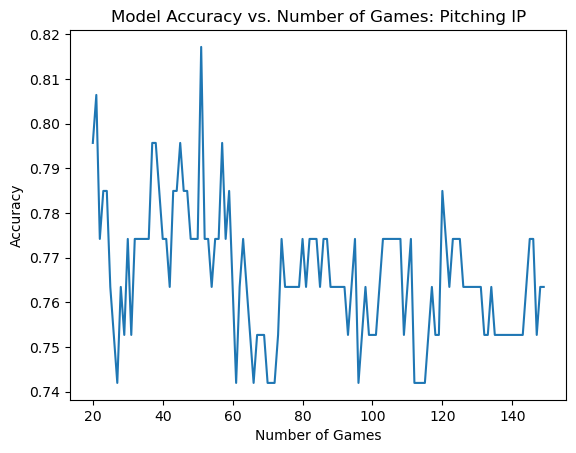

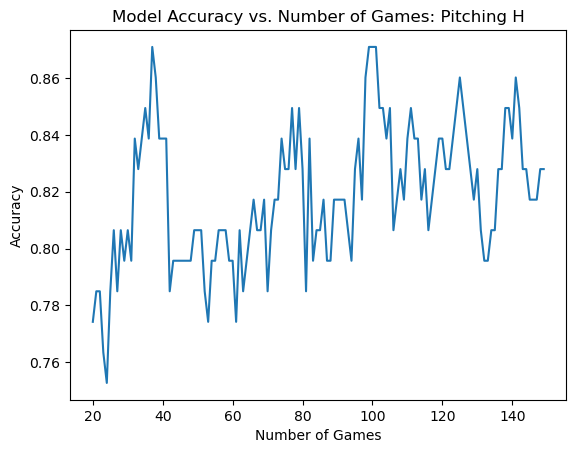

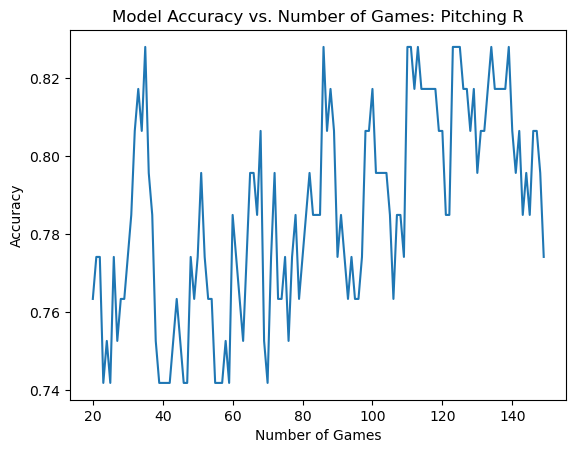

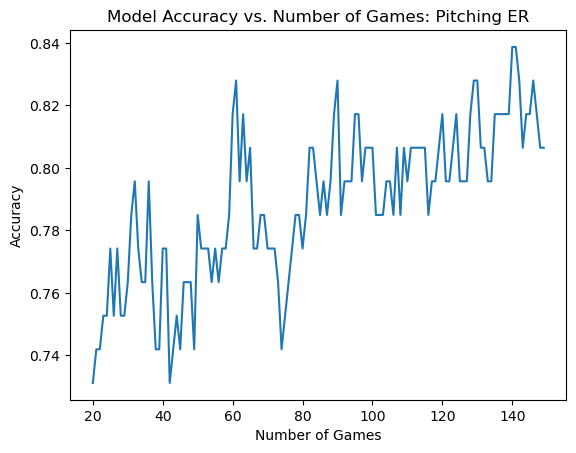

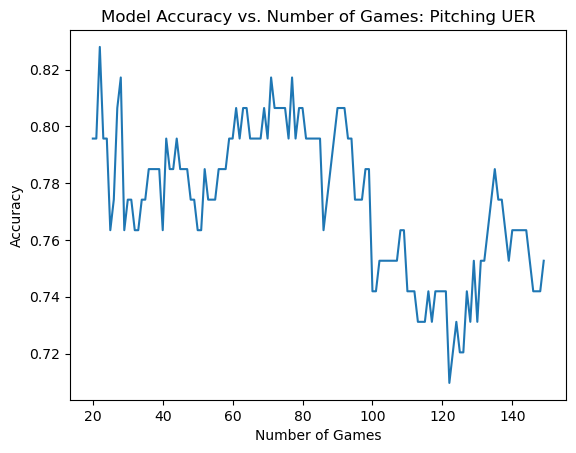

...

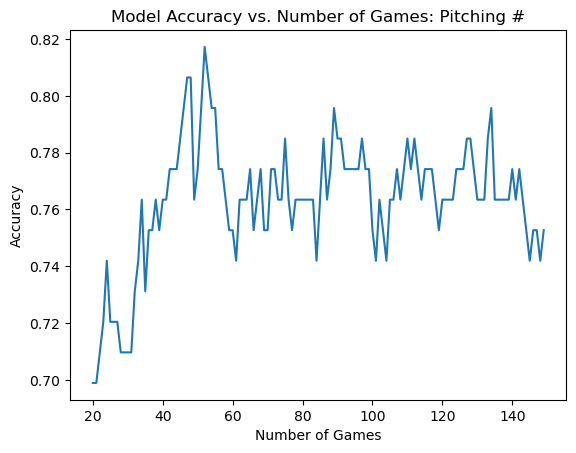

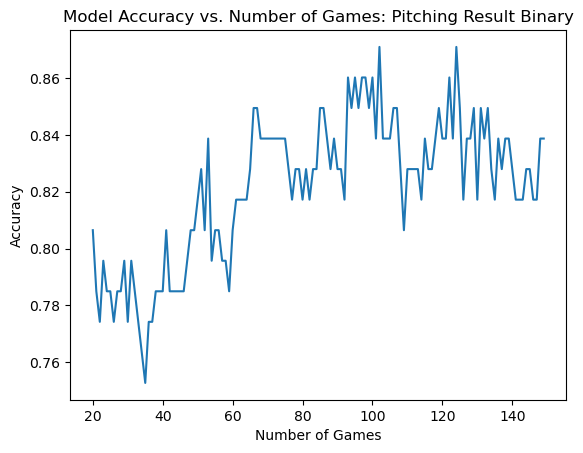

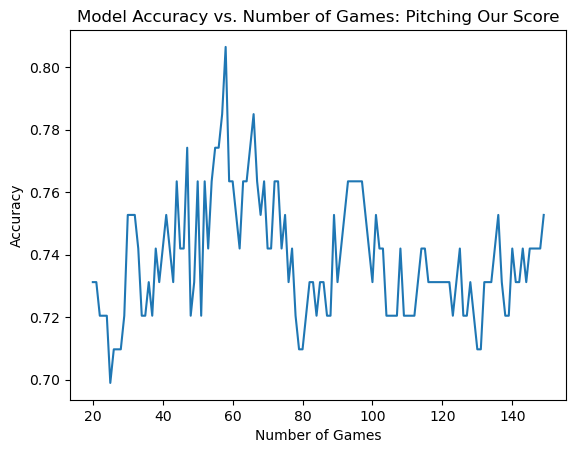

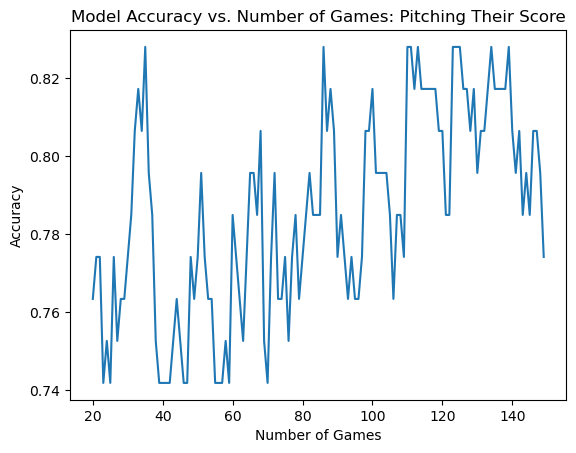

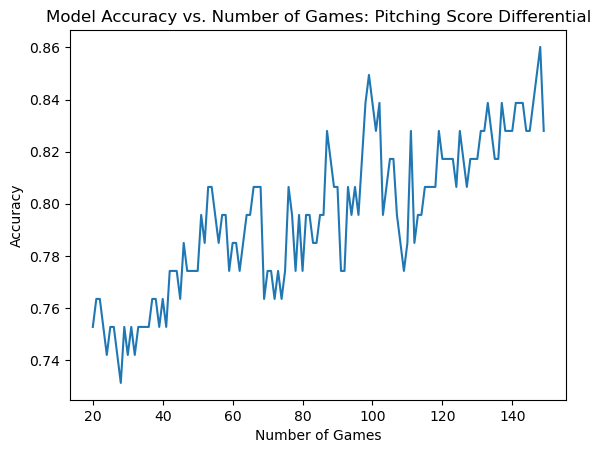

In [50]:
x = 0
for i in range(len(df_list[30].columns)):
    if (df_list[30].columns[i] != '3B') and (df_list[30].columns[i] != 'SB') and (df_list[30].columns[i] != 'HBP') and (df_list[30].columns[i] != 'CS') and (df_list[30].columns[i] != 'IBB') and (df_list[30].columns[i] != 'IR') and (df_list[30].columns[i] != 'IS'):
        plt.plot(num_of_games_pitching[x], pitching_prediction_accuracy[x])
        plt.title(f'Model Accuracy vs. Number of Games: Pitching {df_list[30].columns[i]}')
        plt.xlabel(f'Number of Games')
        plt.ylabel(f'Accuracy')
        plt.savefig(f'Pitching Model Accuracy__{df_list[30].columns[i]}.jpg')
        plt.show()
        x += 1

# for i in range(len(df_list[30].columns)):
#     plt.plot(num_of_games_pitching[i], pitching_prediction_accuracy[i])
    
# plt.title(f'Model Accuracy vs. Number of Games: Pitching')
# plt.legend([f'{df_list[30].columns[i]}' for i in range(len(df_list[30].columns))])
# plt.xlabel(f'Number of Games')
# plt.ylabel(f'Accuracy')
# plt.savefig('Pitching Accuracy.jpg')
# plt.show()

In [39]:
avg_acc_pitching_1 = np.mean(pitching_prediction_accuracy[0:13], axis= 1)
avg_acc_pitching_2 = np.mean(pitching_prediction_accuracy[15:30], axis= 1)
avg_acc_pitching = np.concatenate((avg_acc_pitching_1, avg_acc_pitching_2))

In [40]:
# don't use indices 13 and 14 from the columns
# print(f'{df_list[30].columns[29]}, average accuracy: {avg_acc_pitching[27]}')
# print(f'{df_list[30].columns[26]}, average accuracy: {avg_acc_pitching[24]}')
# print(f'{df_list[30].columns[9]}, average accuracy: {avg_acc_pitching[9]}')
# print(f'{df_list[30].columns[1]}, average accuracy: {avg_acc_pitching[1]}')
# print(f'{df_list[30].columns[6]}, average accuracy: {avg_acc_pitching[6]}')
# print()
# print()
# print()
# print(f'{df_list[30].columns[19]}, average accuracy: {avg_acc_pitching[17]}')
# print(f'{df_list[30].columns[15]}, average accuracy: {avg_acc_pitching[13]}')
# print(f'{df_list[30].columns[8]}, average accuracy: {avg_acc_pitching[8]}')
# print(f'{df_list[30].columns[16]}, average accuracy: {avg_acc_pitching[14]}')
# print(f'{df_list[30].columns[20]}, average accuracy: {avg_acc_pitching[18]}')

print(avg_acc_pitching)

[0.76592225 0.81861042 0.78569065 0.78842018 0.77353184 0.79379653
 0.77593052 0.72729529 0.76790736 0.78933002 0.75268817 0.75434243
 0.7853598  0.78957816 0.78577337 0.78047974 0.76319272 0.82150538
 0.73879239 0.78569065 0.79495451]


#### Next steps
 - Use cross validation to make sure we have the proper number of neighbors.
 - Talk about final steps. State that we weren't able to achieve a wonderful prediction model, but we were able to narrow in on key statistics.
    - Possibly talk about using win streaks for prediction... or actually do it
 - Create presentation/notebook covering topics from the rubric
 - Create slide video (figure out how to do this)

In [41]:
# # Cross validation
# X_batting_cv = np.array([df_list[i]['Score Differential'][0:150].values for i in range(len(df_list)) if len(df_list[i].columns) == 28])
# y_batting_cv = np.array([label_list[i] for i in range(len(label_list)) if len(df_list[i].columns) == 28])
# k_array = []
# for k in range(2,100):
#     model = KNeighborsClassifier(n_neighbors= k)
#     score = cross_val_score(estimator = model, X= X_batting_cv, y= y_batting_cv, cv=5, scoring= 'accuracy')
#     k_array.append(score.mean())

# # Prediction Accuracy 
# accuracy_temp = []
# x_range = []
  
# for k in range(10, 150):
#     try:
#         X_batting = np.array([df_list[i]['Score Differential'][0:k].values for i in range(len(df_list)) if len(df_list[i].columns) == 28])
#         y_batting = np.array([label_list[i] for i in range(len(label_list)) if len(df_list[i].columns) == 28])
        
#         X_train, X_test, y_train, y_test = train_test_split(X_batting, y_batting, random_state=1, test_size=0.7)
        
#         model = KNeighborsClassifier(n_neighbors = 7)
#         model.fit(X_batting, y_batting)

#         y_pred = model.predict(X_test)
#         accuracy_temp.append(metrics.accuracy_score(y_true = y_test, y_pred = y_pred))
#         x_range.append(k)
#     except:
#         pass
    
# plt.plot(np.arange(2, 100), k_array)
# plt.xlabel('# of Neighbors')
# plt.ylabel('Cross Val. Score')
# plt.title('Cross Validation Results: Score Differential')
# plt.savefig('cross_val_score_differential.jpg')
# plt.show()
# print(np.argmax(k_array))

# plt.plot(x_range, accuracy_temp)
# plt.title(f'Model Accuracy vs. Number of Games: Batting Score Differential')
# plt.xlabel(f'Number of Games')
# plt.ylabel(f'Accuracy')
# plt.savefig(f'new_Batting Model Accuracy__Score_Differential.jpg')
# plt.show()
# print(np.mean(accuracy_temp))

In [42]:
# X_batting_cv = np.array([df_list[i]['Result Binary'][0:150].values for i in range(len(df_list)) if len(df_list[i].columns) == 28])
# y_batting_cv = np.array([label_list[i] for i in range(len(label_list)) if len(df_list[i].columns) == 28])
# k_array = []
# for k in range(2,100):
#     model = KNeighborsClassifier(n_neighbors= k)
#     score = cross_val_score(estimator = model, X= X_batting_cv, y= y_batting_cv, cv=5, scoring= 'accuracy')
#     k_array.append(score.mean())
    
# # Prediction Accuracy 
# accuracy_temp = []
# x_range = []
  
# for k in range(10, 150):
#     try:
#         X_batting = np.array([df_list[i]['Result Binary'][0:k].values for i in range(len(df_list)) if len(df_list[i].columns) == 28])
#         y_batting = np.array([label_list[i] for i in range(len(label_list)) if len(df_list[i].columns) == 28])
        
#         X_train, X_test, y_train, y_test = train_test_split(X_batting, y_batting, random_state=1, test_size=0.7)
        
#         model = KNeighborsClassifier(n_neighbors = 8)
#         model.fit(X_batting, y_batting)

#         y_pred = model.predict(X_test)
#         accuracy_temp.append(metrics.accuracy_score(y_true = y_test, y_pred = y_pred))
#         x_range.append(k)
#     except:
#         pass
    
# plt.plot(np.arange(2, 100), k_array)
# plt.xlabel('# of Neighbors')
# plt.ylabel('Cross Val. Score')
# plt.title('Cross Validation Results: Result Binary')
# plt.savefig('cross_val_result_binary.jpg')
# plt.show()
# print(np.argmax(k_array))

# plt.plot(x_range, accuracy_temp)
# plt.title(f'Model Accuracy vs. Number of Games: Batting Result Binary')
# plt.xlabel(f'Number of Games')
# plt.ylabel(f'Accuracy')
# plt.savefig(f'new_Batting Model Accuracy__Result Binary.jpg')
# plt.show()
# print(np.mean(accuracy_temp))


In [43]:
# X_batting_cv = np.array([df_list[i]['OPS'][0:150].values for i in range(len(df_list)) if len(df_list[i].columns) == 28])
# y_batting_cv = np.array([label_list[i] for i in range(len(label_list)) if len(df_list[i].columns) == 28])
# k_array = []
# for k in range(2,100):
#     model = KNeighborsClassifier(n_neighbors= k)
#     score = cross_val_score(estimator = model, X= X_batting_cv, y= y_batting_cv, cv=5, scoring= 'accuracy')
#     k_array.append(score.mean())
    
# # Prediction Accuracy 
# accuracy_temp = []
# x_range = []
  
# for k in range(10, 150):
#     try:
#         X_batting = np.array([df_list[i]['OPS'][0:k].values for i in range(len(df_list)) if len(df_list[i].columns) == 28])
#         y_batting = np.array([label_list[i] for i in range(len(label_list)) if len(df_list[i].columns) == 28])
        
#         X_train, X_test, y_train, y_test = train_test_split(X_batting, y_batting, random_state=1, test_size=0.7)
        
#         model = KNeighborsClassifier(n_neighbors = 9)
#         model.fit(X_batting, y_batting)

#         y_pred = model.predict(X_test)
#         accuracy_temp.append(metrics.accuracy_score(y_true = y_test, y_pred = y_pred))
#         x_range.append(k)
#     except:
#         pass
    
# plt.plot(np.arange(2, 100), k_array)
# plt.xlabel('# of Neighbors')
# plt.ylabel('Cross Val. Score')
# plt.title('Cross Validation Results: OPS')
# plt.savefig('cross_val_OPS.jpg')
# plt.show()
# print(np.argmax(k_array))

# plt.plot(x_range, accuracy_temp)
# plt.title(f'Model Accuracy vs. Number of Games: Batting OPS')
# plt.xlabel(f'Number of Games')
# plt.ylabel(f'Accuracy')
# plt.savefig(f'new_Batting Model Accuracy__OPS.jpg')
# plt.show()
# print(np.mean(accuracy_temp))

In [44]:
# X_batting_cv = np.array([df_list[i]['SLG'][0:150].values for i in range(len(df_list)) if len(df_list[i].columns) == 28])
# y_batting_cv = np.array([label_list[i] for i in range(len(label_list)) if len(df_list[i].columns) == 28])
# k_array = []
# for k in range(2,100):
#     model = KNeighborsClassifier(n_neighbors= k)
#     score = cross_val_score(estimator = model, X= X_batting_cv, y= y_batting_cv, cv=5, scoring= 'accuracy')
#     k_array.append(score.mean())
    
# # Prediction Accuracy 
# accuracy_temp = []
# x_range = []
  
# for k in range(10, 150):
#     try:
#         X_batting = np.array([df_list[i]['SLG'][0:k].values for i in range(len(df_list)) if len(df_list[i].columns) == 28])
#         y_batting = np.array([label_list[i] for i in range(len(label_list)) if len(df_list[i].columns) == 28])
        
#         X_train, X_test, y_train, y_test = train_test_split(X_batting, y_batting, random_state=1, test_size=0.7)
        
#         model = KNeighborsClassifier(n_neighbors = 10)
#         model.fit(X_batting, y_batting)

#         y_pred = model.predict(X_test)
#         accuracy_temp.append(metrics.accuracy_score(y_true = y_test, y_pred = y_pred))
#         x_range.append(k)
#     except:
#         pass
    
# plt.plot(np.arange(2, 100), k_array)
# plt.xlabel('# of Neighbors')
# plt.ylabel('Cross Val. Score')
# plt.title('Cross Validation Results: SLG')
# plt.savefig('cross_val_SLG.jpg')
# plt.show()
# print(np.argmax(k_array))

# plt.plot(x_range, accuracy_temp)
# plt.title(f'Model Accuracy vs. Number of Games: Batting SLG')
# plt.xlabel(f'Number of Games')
# plt.ylabel(f'Accuracy')
# plt.savefig(f'new_Batting Model Accuracy__SLG.jpg')
# plt.show()
# print(np.mean(accuracy_temp))

In [45]:
# X_batting_cv = np.array([df_list[i]['OBP'][0:150].values for i in range(len(df_list)) if len(df_list[i].columns) == 28])
# y_batting_cv = np.array([label_list[i] for i in range(len(label_list)) if len(df_list[i].columns) == 28])
# k_array = []
# for k in range(2,100):
#     model = KNeighborsClassifier(n_neighbors= k)
#     score = cross_val_score(estimator = model, X= X_batting_cv, y= y_batting_cv, cv=5, scoring= 'accuracy')
#     k_array.append(score.mean())
    
# # Prediction Accuracy 
# accuracy_temp = []
# x_range = []
  
# for k in range(10, 150):
#     try:
#         X_batting = np.array([df_list[i]['OBP'][0:k].values for i in range(len(df_list)) if len(df_list[i].columns) == 28])
#         y_batting = np.array([label_list[i] for i in range(len(label_list)) if len(df_list[i].columns) == 28])
        
#         X_train, X_test, y_train, y_test = train_test_split(X_batting, y_batting, random_state=1, test_size=0.7)
        
#         model = KNeighborsClassifier(n_neighbors = 9)
#         model.fit(X_batting, y_batting)

#         y_pred = model.predict(X_test)
#         accuracy_temp.append(metrics.accuracy_score(y_true = y_test, y_pred = y_pred))
#         x_range.append(k)
#     except:
#         pass
    
# plt.plot(np.arange(2, 100), k_array)
# plt.xlabel('# of Neighbors')
# plt.ylabel('Cross Val. Score')
# plt.title('Cross Validation Results: OBP')
# plt.savefig('cross_val_OBP.jpg')
# plt.show()
# print(np.argmax(k_array))

# plt.plot(x_range, accuracy_temp)
# plt.title(f'Model Accuracy vs. Number of Games: Batting OBP')
# plt.xlabel(f'Number of Games')
# plt.ylabel(f'Accuracy')
# plt.savefig(f'new_Batting Model Accuracy__OBP.jpg')
# plt.show()
# print(np.mean(accuracy_temp))

In [46]:
# X_batting_cv = np.array([df_list[i]['BA'][0:150].values for i in range(len(df_list)) if len(df_list[i].columns) == 28])
# y_batting_cv = np.array([label_list[i] for i in range(len(label_list)) if len(df_list[i].columns) == 28])
# k_array = []
# for k in range(2,100):
#     model = KNeighborsClassifier(n_neighbors= k)
#     score = cross_val_score(estimator = model, X= X_batting_cv, y= y_batting_cv, cv=5, scoring= 'accuracy')
#     k_array.append(score.mean())
    
# # Prediction Accuracy 
# accuracy_temp = []
# x_range = []
  
# for k in range(10, 150):
#     try:
#         X_batting = np.array([df_list[i]['BA'][0:k].values for i in range(len(df_list)) if len(df_list[i].columns) == 28])
#         y_batting = np.array([label_list[i] for i in range(len(label_list)) if len(df_list[i].columns) == 28])
        
#         X_train, X_test, y_train, y_test = train_test_split(X_batting, y_batting, random_state=1, test_size=0.7)
        
#         model = KNeighborsClassifier(n_neighbors = 15)
#         model.fit(X_batting, y_batting)

#         y_pred = model.predict(X_test)
#         accuracy_temp.append(metrics.accuracy_score(y_true = y_test, y_pred = y_pred))
#         x_range.append(k)
#     except:
#         pass
    
# plt.plot(np.arange(2, 100), k_array)
# plt.xlabel('# of Neighbors')
# plt.ylabel('Cross Val. Score')
# plt.title('Cross Validation Results: BA')
# plt.savefig('cross_val_BA.jpg')
# plt.show()
# print(np.argmax(k_array))

# plt.plot(x_range, accuracy_temp)
# plt.title(f'Model Accuracy vs. Number of Games: Batting BA')
# plt.xlabel(f'Number of Games')
# plt.ylabel(f'Accuracy')
# plt.savefig(f'new_Batting Model Accuracy__BA.jpg')
# plt.show()
# print(np.mean(accuracy_temp))